<a href="https://colab.research.google.com/github/elrichgro/irccam-pmodwrc/blob/main/irccam/notebooks/model_predictions.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Get code
%cd /content
!rm -rf irccam-pmodwrc/
!git clone https://github.com/elrichgro/irccam-pmodwrc.git

/content
Cloning into 'irccam-pmodwrc'...
remote: Enumerating objects: 136, done.
remote: Counting objects: 100% (136/136), done.
remote: Compressing objects: 100% (91/91), done.
remote: Total 811 (delta 77), reused 99 (delta 45), pack-reused 675
Receiving objects: 100% (811/811), 103.17 MiB | 31.11 MiB/s, done.
Resolving deltas: 100% (490/490), done.


In [2]:
#  Mount data
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


## Requirements and copy data

In [3]:
requirements = """
torch
torchvision
tqdm
h5py
jupyterlab
opencv-contrib-python
opencv-python
pytorch-lightning==1.0.5
future==0.17.1
scipy
scikit-learn
astral
test-tube
pysolar
"""

with open('requirements.txt', 'w') as f:
  f.write(requirements)

!pip install -r requirements.txt

     |████████████████████████████████| 7.9MB 5.9MB/s 
     |████████████████████████████████| 563kB 44.1MB/s 
     |████████████████████████████████| 829kB 29.7MB/s 
     |████████████████████████████████| 51kB 6.6MB/s 
     |████████████████████████████████| 276kB 47.3MB/s 
     |████████████████████████████████| 92kB 10.8MB/s 
     |████████████████████████████████| 61kB 6.8MB/s 
  Created wheel for future: filename=future-0.17.1-cp36-none-any.whl size=488730 sha256=1a16f93a7a565b4c6c53a474616bfc452331b53561bdaf913831b7a02f208e10
  Stored in directory: /root/.cache/pip/wheels/0c/61/d2/d6b7317325828fbb39ee6ad559dbe4664d0896da4721bf379e
  Created wheel for test-tube: filename=test_tube-0.7.5-cp36-none-any.whl size=25358 sha256=0c4be5e77de27fe40e804c5b83fb67da35e2dad6309a401359190a2fa9d7d3f6
  Stored in directory: /root/.cache/pip/wheels/02/52/96/c8b6f3c345cfd3284845ef50818c6996a5658006fe50e40e98
  Created wheel for PyYAML: filename=PyYAML-5.3.1-cp36-cp36m-linux_x86_64.whl size=44620 s

In [4]:
## Copy data
!rm -rf /content/data
!mkdir /content/data
!time cp /content/drive/My\ Drive/dsl/datasets/optimized_3/*.h5 /content/data
!time cp /content/drive/My\ Drive/dsl/datasets/optimized_3/*.txt /content/data


real	3m41.263s
user	0m0.045s
sys	0m8.435s

real	0m1.283s
user	0m0.001s
sys	0m0.006s


## Predictions

In [3]:
%cd /content/irccam-pmodwrc/

/content/irccam-pmodwrc


In [17]:
from irccam.training.cloud_segmentation import CloudSegmentation
from irccam.utils.constants import *
from irccam.datasets.cloud_dataset import HDF5Dataset
import torch
import matplotlib.pyplot as plt
import h5py
import cv2
import numpy as np
from tqdm.auto import tqdm
from torchvision import transforms
import matplotlib.gridspec as gridspec
%matplotlib inline

In [5]:
!ls "/content/drive/My Drive/dsl/training_logs/20201215152108-experiment_deeplab/tube_logs/version_0/checkpoints"

'best-epoch=12-val_iou=0.77.ckpt'   last.ckpt


In [6]:
# checkpoint_path = "/content/drive/My Drive/dsl/training_logs/20201210153924-colab_test/tube_logs/version_0/checkpoints/best-epoch=14-val_iou=0.70.ckpt" # 4
# checkpoint_path = "/content/drive/My Drive/dsl/training_logs/20201212171412-colab_test/tube_logs/version_0/checkpoints/best-epoch=13-val_iou=0.69.ckpt" # 3
# checkpoint_path = "/content/drive/My Drive/dsl/training_logs/20201212181755-colab_test/tube_logs/version_0/checkpoints/best-epoch=15-val_iou=0.71.ckpt" # 3
# checkpoint_path = "/content/drive/My Drive/dsl/training_logs/20201214160050-colab_test/tube_logs/version_0/checkpoints/best-epoch=15-val_iou=0.74.ckpt" # 3
# checkpoint_path = "/content/drive/My Drive/dsl/training_logs/20201214180149-colab_test/tube_logs/version_0/checkpoints/best-epoch=14-val_iou=0.74.ckpt" # 3
# checkpoint_path = "/content/drive/My Drive/dsl/training_logs/20201214195914-experiment_lr=0001/tube_logs/version_0/checkpoints/best-epoch=15-val_iou=0.76.ckpt" # 3
# checkpoint_path = "/content/drive/My Drive/dsl/training_logs/20201215103838-experiment_lr=0001_batchsize=8/tube_logs/version_0/checkpoints/best-epoch=27-val_iou=0.77.ckpt" # 3
# checkpoint_path = "/content/drive/My Drive/dsl/training_logs/20201215124005-experiment_lr=0001_optimized_4/tube_logs/version_0/checkpoints/best-epoch=10-val_iou=0.74.ckpt" # Optimized 4
checkpoint_path = "/content/drive/My Drive/dsl/training_logs/20201215152108-experiment_deeplab/tube_logs/version_0/checkpoints/best-epoch=12-val_iou=0.77.ckpt" # 3

In [7]:
model = CloudSegmentation.load_from_checkpoint(checkpoint_path)

In [8]:
trans = transforms.Compose([transforms.ToTensor(),])
test_data = HDF5Dataset("/content/drive/My Drive/dsl/datasets/optimized_3/", "test", trans, use_clear_sky=True, use_sun_mask=True)
test_data_no_sky = HDF5Dataset("/content/drive/My Drive/dsl/datasets/optimized_3/", "test", trans, use_clear_sky=False, use_sun_mask=False)
test_data_no_mask = HDF5Dataset("/content/drive/My Drive/dsl/datasets/optimized_3/", "test", trans, use_clear_sky=True, use_sun_mask=False)

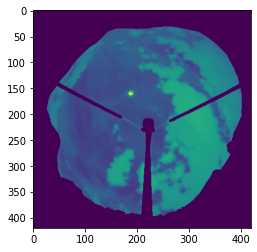

In [21]:
plt.imshow(test_data_no_mask[120]['irc'].squeeze())

In [9]:
def get_vis_img(timestamp):
  file = "/content/drive/My Drive/dsl/datasets/main_3/{}.h5".format(timestamp[:8])
  with h5py.File(file, 'r') as f:
    idx = None
    for i, ts in enumerate(f['timestamp']):
      if timestamp[:12] in ts:
        idx = i
        break
    assert idx is not None, "Could not find image for timestamp {}".format(timestamp)
    return cv2.cvtColor(np.nan_to_num(f['vis'][idx], nan=255).astype(np.uint8), cv2.COLOR_BGR2RGB)

In [10]:
# Plot results
def plot_ax(gs, img):
  ax = plt.subplot(gs)
  plt.axis('off')
  ax.set_xticklabels([])
  ax.set_yticklabels([])
  ax.imshow(img)

def plot_results(results):
  dim_size = 5
  rows = len(results)
  cols = len(results[0])
  plt.figure(figsize = (dim_size*cols,dim_size*rows))
  gs = gridspec.GridSpec(rows, cols)
  gs.update(wspace=0.025, hspace=0.05) # set the spacing between axes. 

  for i in range(rows):
    for j in range(cols):
      plot_ax(gs[i*cols+j], results[i][j])

  plt.show()

def save_results(results, filename):
  dim_size = 5
  rows = len(results)
  cols = len(results[0])
  plt.figure(figsize = (dim_size*cols,dim_size*rows))
  gs = gridspec.GridSpec(rows, cols)
  gs.update(wspace=0.025, hspace=0.05) # set the spacing between axes. 

  for i in range(rows):
    for j in range(cols):
      plot_ax(gs[i*cols+j], results[i][j])

  plt.gca().set_axis_off()
  plt.subplots_adjust(top = 1, bottom = 0, right = 1, left = 0, 
              hspace = 0, wspace = 0)
  plt.margins(0,0)
  plt.gca().xaxis.set_major_locator(plt.NullLocator())
  plt.gca().yaxis.set_major_locator(plt.NullLocator())
  plt.savefig(filename, bbox_inches = 'tight', pad_inches = 0)
  plt.close()

In [11]:
from irccam.datasets.preprocessing import process_irccam_img
from irccam.datasets.create_dataset import convert_timestamp

def get_pmod_label(timestamp):
  day = timestamp[:8]
  file = "/content/drive/My Drive/dsl/irccam/irccam_{}_rad.mat".format(day)
  with h5py.File(file, 'r') as f:
    idx = None
    for i, ts in enumerate(f['TM'][0]):
      if timestamp == convert_timestamp(day, ts).strftime('%Y%m%d%H%M%S'):
        idx = i
        break
    assert idx is not None, "Could not find image for timestamp {}".format(timestamp)
    cloud = process_irccam_img(f['CLOUDS'][idx])
    cloud = np.nan_to_num(cloud, copy=False, nan=0.0)
    cloud[cloud != 0] = 1
    return cloud

In [12]:
from irccam.datasets.masking import apply_full_mask

def predict(model, input):
  pred = model.model(input.unsqueeze(0))
  pred = torch.argmax(pred, 1).squeeze().numpy()
  apply_full_mask(pred, fill=0)
  return pred

In [19]:
def get_data_and_pred(model, idx, dataset=test_data):
  data = dataset[idx]
  timestamp = data['timestamp']
  irc = data['irc']
  # irc[irc>0.7] = 0.3
  vis = get_vis_img(timestamp)
  label = data['label'].squeeze().numpy()
  pmod_label = get_pmod_label(timestamp)
  pred = predict(model, irc)
  return [vis, irc.squeeze(), pred, pmod_label, label, timestamp]

In [27]:
results = []
model.eval()
for i in range(120, 130):
  results.append(get_data_and_pred(model, i, dataset=test_data_no_mask)[:5])

20180610093004


/content/irccam-pmodwrc/irccam/datasets/image_processing.py:82: RuntimeWarning: invalid value encountered in less
  img_ir[img_ir < mi] = mi
/content/irccam-pmodwrc/irccam/datasets/image_processing.py:83: RuntimeWarning: invalid value encountered in greater
  img_ir[img_ir > ma] = ma


20180610094004
20180610095003
20180610100004
20180610101004
20180610102004
20180610103003
20180610104004
20180610105003
20180610110004


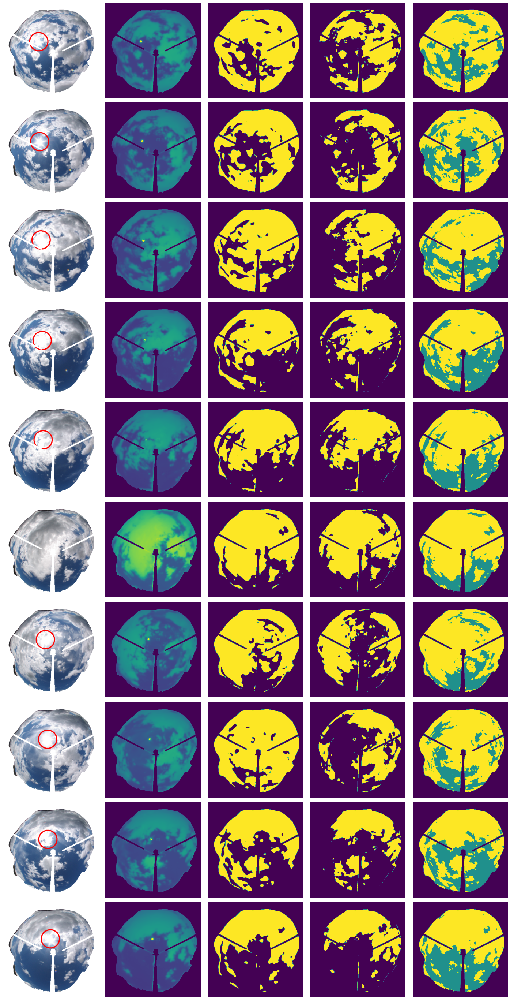

In [28]:
# 20201215152108-experiment_deeplab
plot_results(results)

In [ ]:
# Save all test predictions to drive
model.eval()
for i in tqdm(range(len(test_data_no_mask))):
  result = get_data_and_pred(model, i, dataset=test_data_no_mask)
  save_results([result[:5]], "/content/drive/My Drive/dsl/datasets/notebooks/predictions/20201215152108-experiment_deeplab/{}.png".format(result[5]))

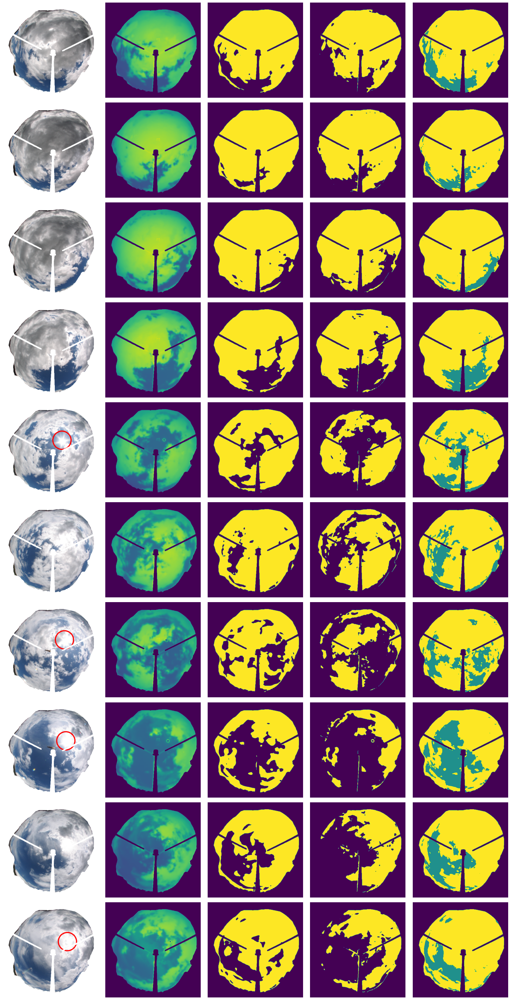

In [52]:
# 20201215124005-experiment_lr=0001_optimized_4 - best-epoch=10-val_iou=0.74.ckpt (optimized 4 20:30)
plot_results(results)

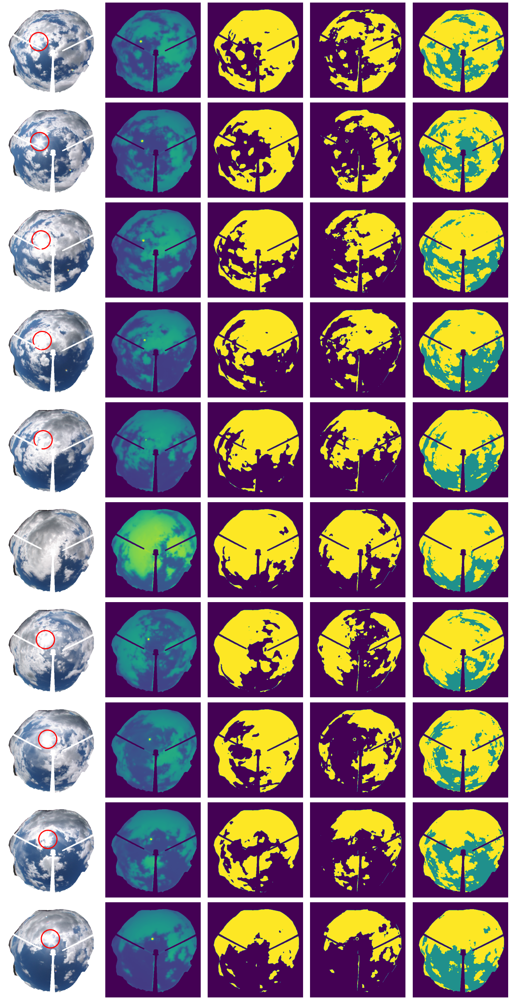

In [43]:
# 20201215103838-experiment_lr=0001_batchsize=8 - best-epoch=27-val_iou=0.77.ckpt (optimized 4 20:30)
plot_results(results)

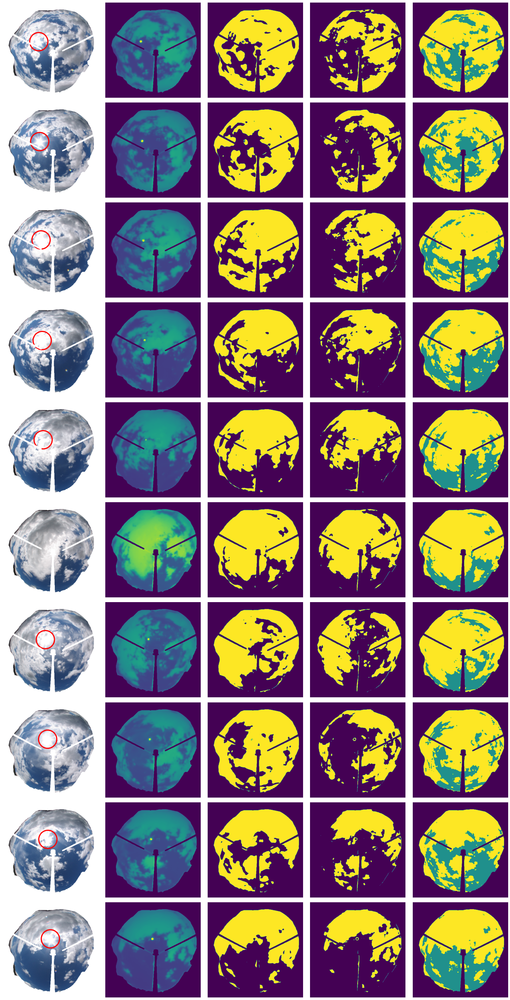

In [37]:
# 20201215103838-experiment_lr=0001_batchsize=8
plot_results(results)

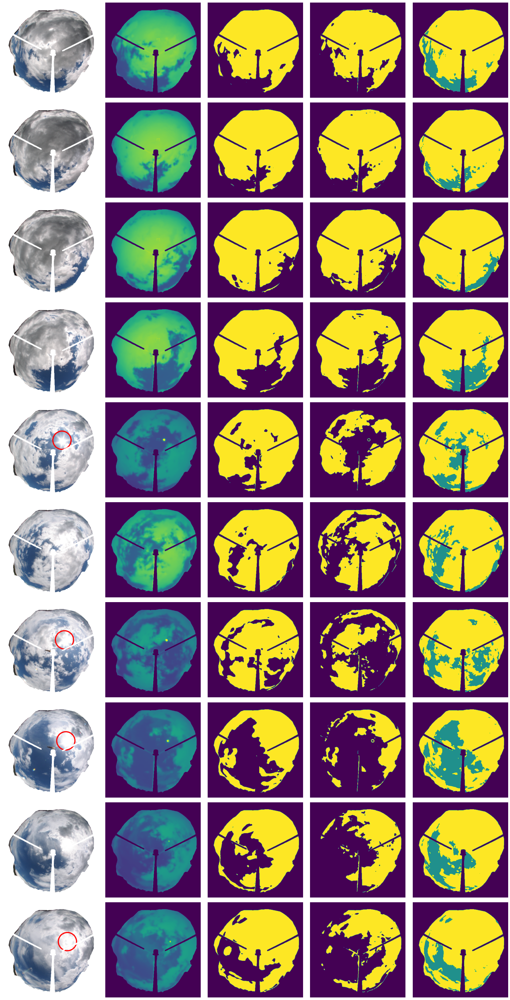

In [29]:
# 20201210153924-colab_test
plot_results(results)

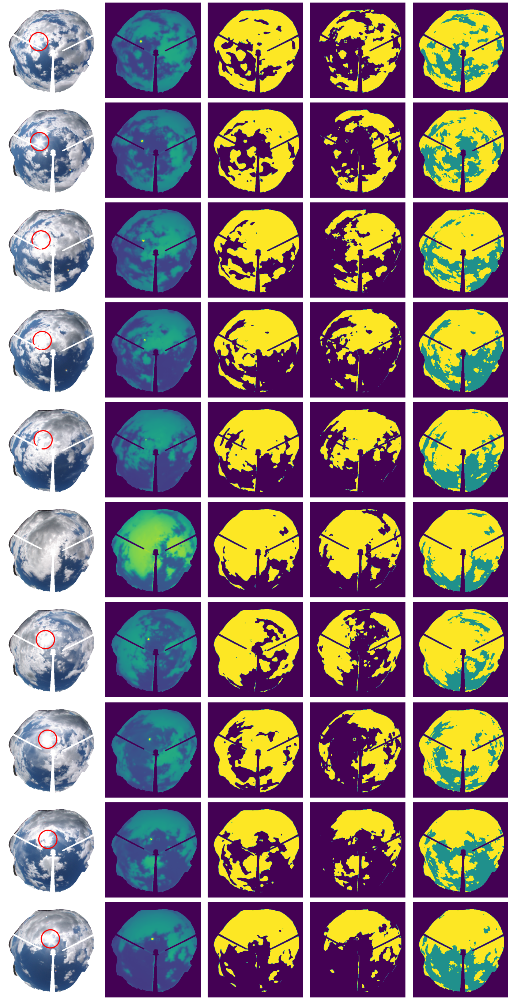

In [17]:
plot_results(results)

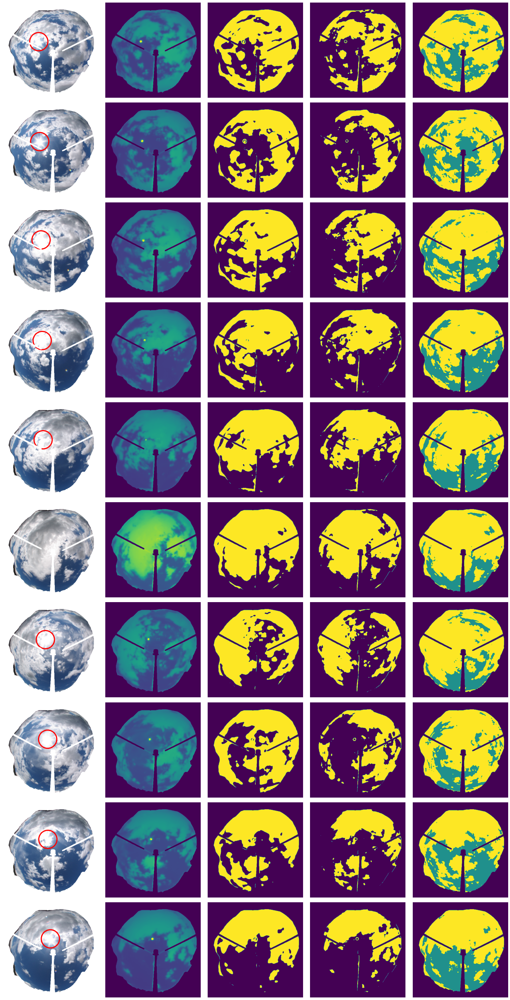

In [103]:
plot_results(results)

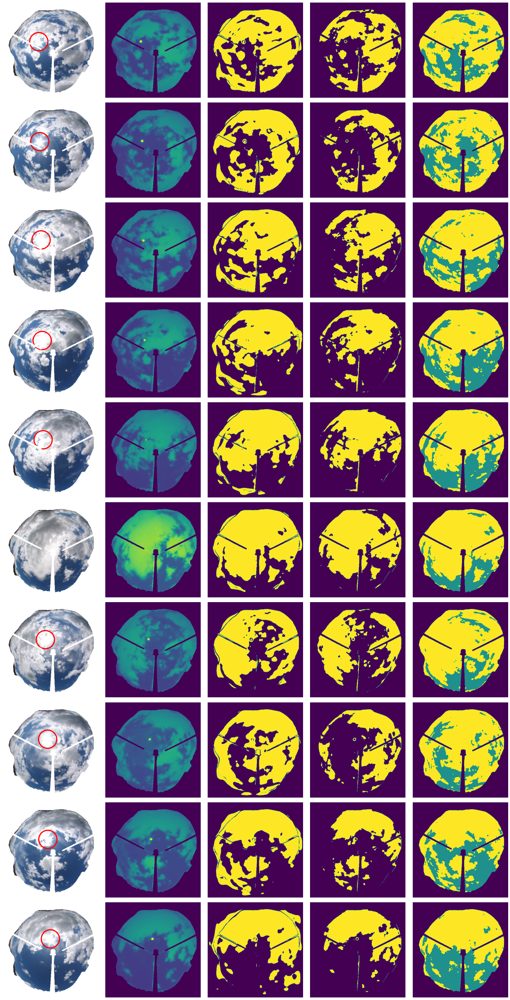

In [54]:
plot_results(results)

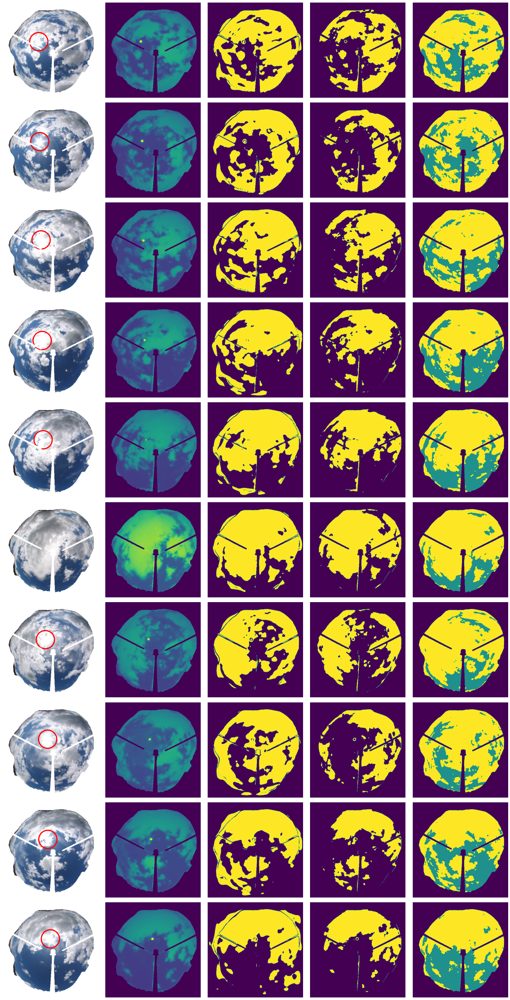

In [33]:
plot_results(results)

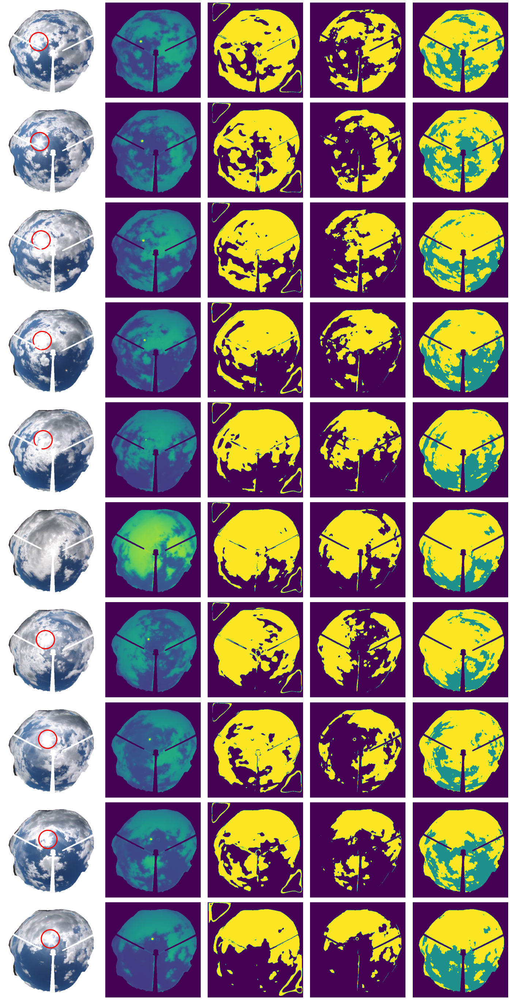

In [105]:
plot_results(results)

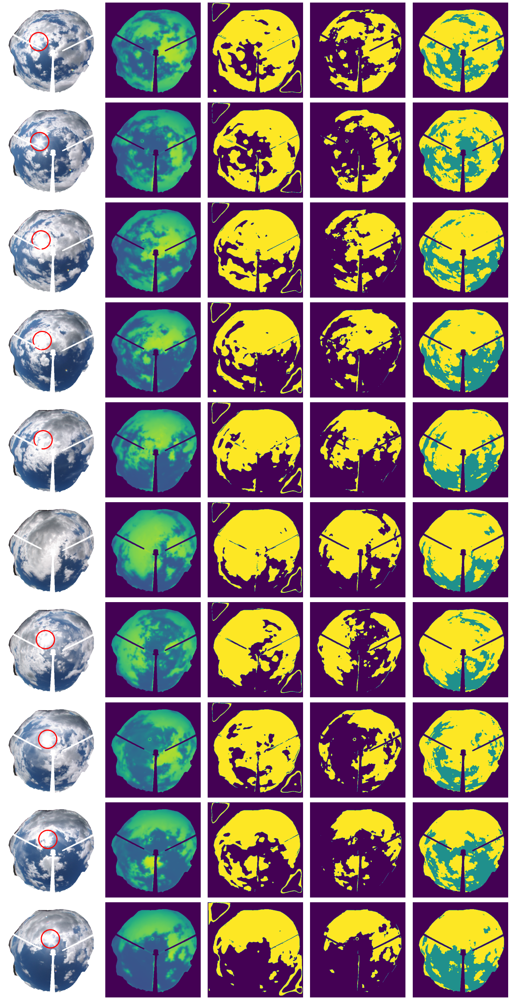

In [103]:
plot_results(results)

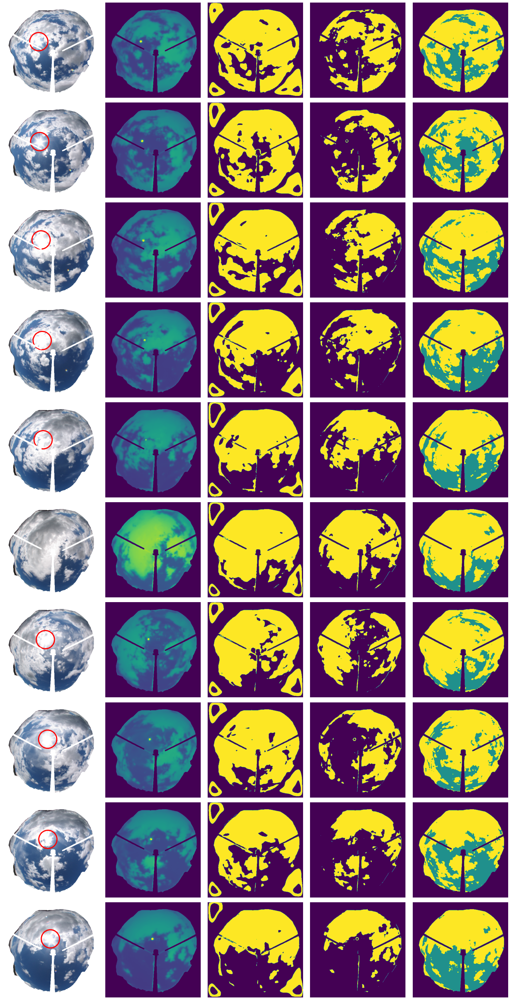

In [67]:
plot_results(results)

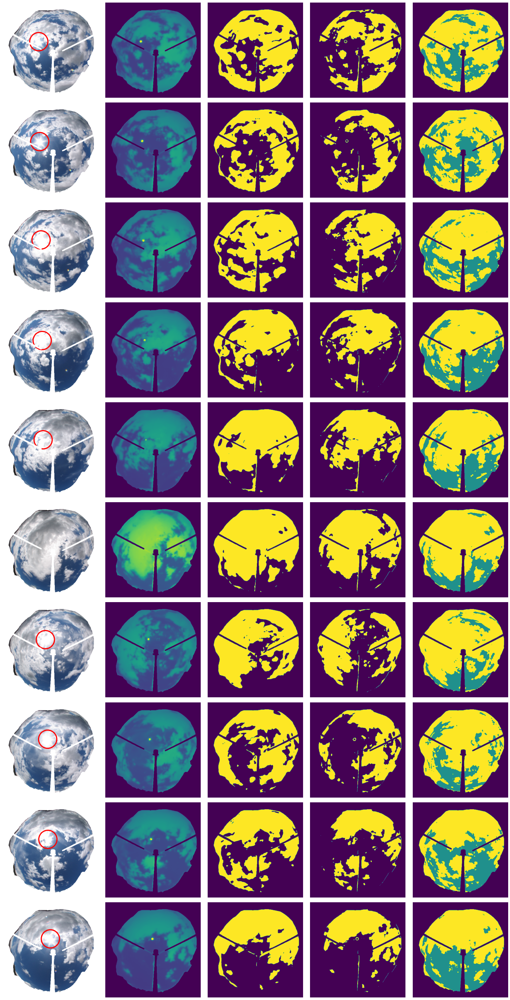

In [62]:
plot_results(results)

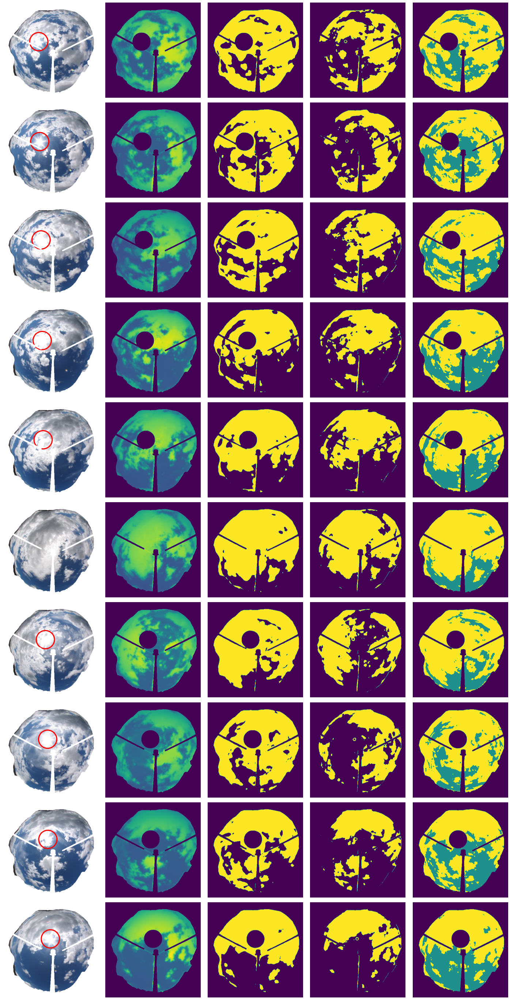

In [58]:
plot_results(results)

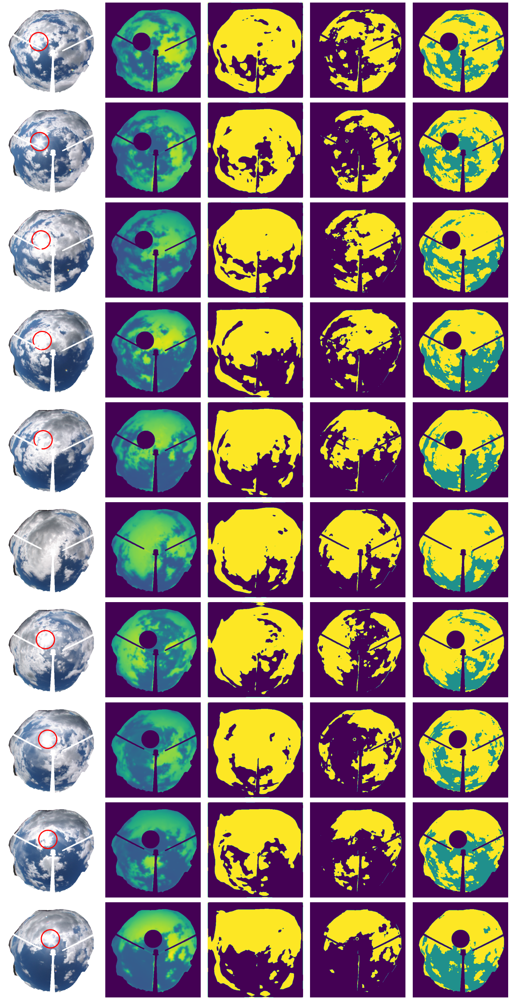

In [52]:
plot_results(results)

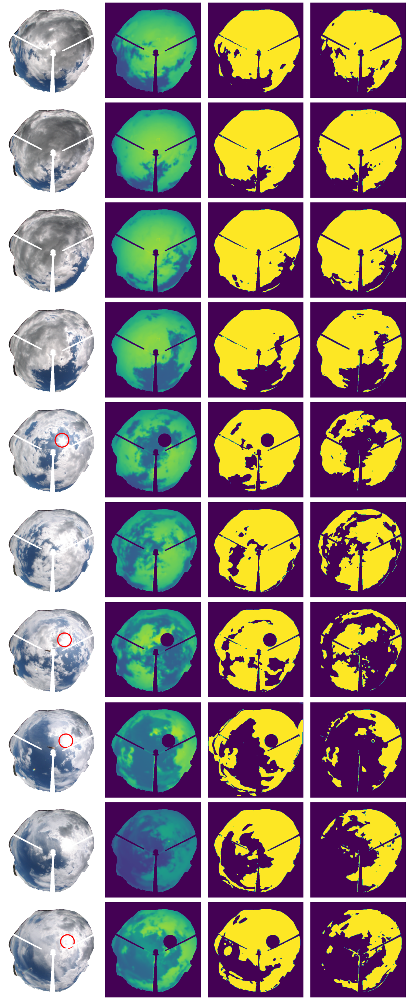

In [ ]:
plot_results(results)

/content/irccam-pmodwrc/irccam/datasets/cloud_dataset.py:118: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  with h5py.File(self.files[file_index]) as h5_file:
/content/irccam-pmodwrc/irccam/datasets/image_processing.py:78: RuntimeWarning: invalid value encountered in less
  img_ir[img_ir < mi] = mi
/content/irccam-pmodwrc/irccam/datasets/image_processing.py:79: RuntimeWarning: invalid value encountered in greater
  img_ir[img_ir > ma] = ma


20181005103504
20181005104503
20181005105503
20181005110503
20181005111504
20181005112505
20181005113504
20181005114504
20181005115504
20181005120505


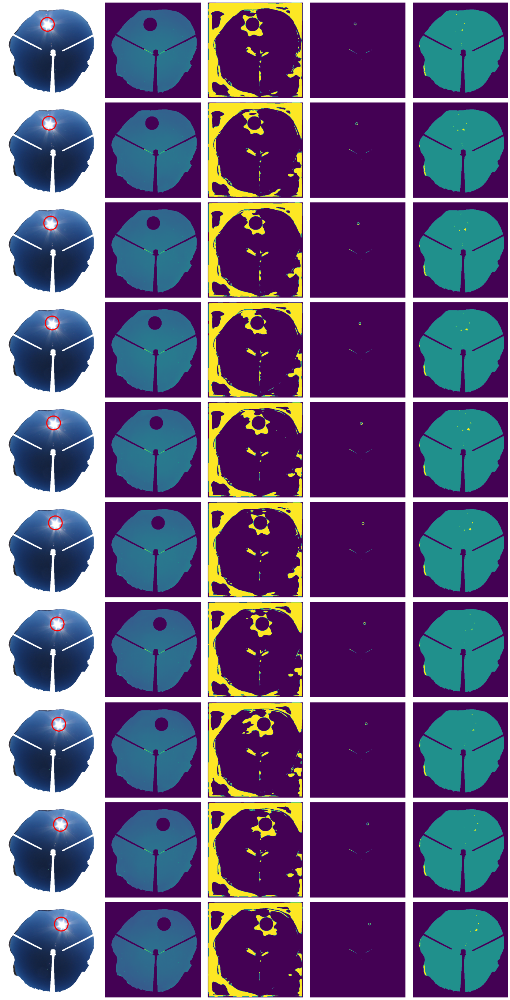

In [ ]:
def get_data_and_pred(idx):
  data = test_data[idx]
  timestamp = data['timestamp']
  print(timestamp)
  irc = data['irc']
  vis = get_vis_img(timestamp)
  label = data['label'].squeeze().numpy()
  pmod_label = get_pmod_label(timestamp)
  pred = model.model(irc.unsqueeze(0))
  pred = torch.argmax(pred, 1).squeeze().numpy()
  return [vis, irc.squeeze(), pred, pmod_label, label]

results = []
for i in range(770, 780):
  results.append(get_data_and_pred(i))

plot_results(results)

776


/content/irccam-pmodwrc/irccam/datasets/cloud_dataset.py:118: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  with h5py.File(self.files[file_index]) as h5_file:


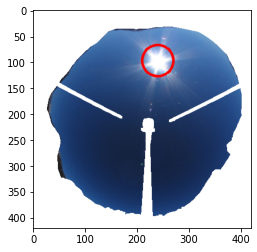

In [ ]:
idx = np.random.randint(0, 1500)
print(idx)
ts = test_data[idx]['timestamp']
vis = get_vis_img(ts)
plt.imshow(vis)

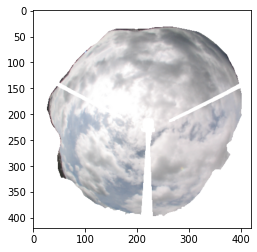

In [ ]:
plt.imshow(vis)

/content/irccam-pmodwrc/irccam/datasets/cloud_dataset.py:118: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  with h5py.File(self.files[file_index]) as h5_file:


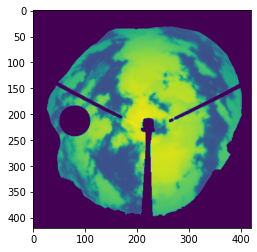

In [ ]:
plt.imshow(test_data[idx]['irc'][0])

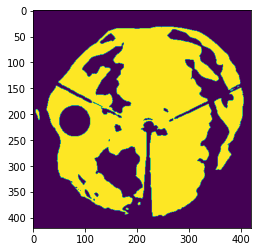

In [ ]:
result = torch.argmax(pred, 1).squeeze().numpy()
plt.imshow(result)

/content/irccam-pmodwrc/irccam/datasets/cloud_dataset.py:118: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  with h5py.File(self.files[file_index]) as h5_file:


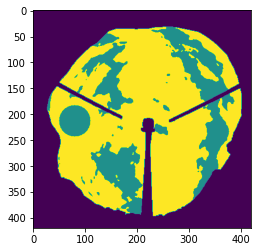

In [ ]:
label = test_data[idx]['label'].squeeze().numpy()
plt.imshow(label)

In [ ]:
model.hparams

"batch_size":      4
"batch_size_val":  8
"dataset_class":   hdf5
"dataset_root":    /content/data
"experiment_name": colab_test
"learning_rate":   0.01
"log_dir":         /content/drive/My Drive/dsl/training_logs
"model_name":      unet
"num_epochs":      16
"use_clear_sky":   True